In [ ]:


import torch
import os
import torchvision
from torchvision.transforms import v2
from PIL import Image
import numpy as np
import os
import matplotlib.pyplot as plt
from tqdm import tqdm
from sklearn.metrics.pairwise import cosine_similarity
from sklearn.metrics import f1_score
from sklearn.metrics import confusion_matrix, roc_auc_score, average_precision_score
from collections import defaultdict


device = torch.device("mps" if torch.backends.mps.is_available() else "cpu")

REPO_DIR = os.path.abspath(
    "/Users/ceciliahaslundoreskov/Desktop/5. semester/Deep_Learning/Project/dinov3"
)

weights = os.path.abspath(
    "/Users/ceciliahaslundoreskov/Desktop/5. semester/Deep_Learning/Project/"
    "dinov3_vits16plus_pretrain_lvd1689m-4057cbaa.pth"
)


model = torch.hub.load(
    repo_or_dir=REPO_DIR,
    model="dinov3_vits16plus",
    source="local",
    weights=weights,          
)

model.to(device).eval()

state_dict = torch.load("/Users/ceciliahaslundoreskov/Desktop/5. semester/Deep_Learning/Project/"
    "dinov3_vits16plus_pretrain_lvd1689m-4057cbaa.pth", map_location='cpu')
model.load_state_dict(state_dict, strict=False)
print("Model loaded successfully from local checkpoint")



def make_transform(resize_size: int = 256):
    to_tensor = v2.ToImage()
    resize = v2.Resize((resize_size, resize_size), antialias=True)
    to_float = v2.ToDtype(torch.float32, scale=True)
    normalize = v2.Normalize(
        mean=(0.485, 0.456, 0.406),
        std=(0.229, 0.224, 0.225),
    )
    return v2.Compose([to_tensor, resize, to_float, normalize])

transform = make_transform(256)



Model loaded successfully from local checkpoint


/var/folders/tk/vby2xctj2yz8kn6p_xgfvcd80000gn/T/ipykernel_14187/3276088786.py:37: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load("/Users/ceciliahaslu

In [ ]:
@torch.no_grad()
def get_embeddings(model, img_path):
    img = Image.open(img_path).convert("RGB")
    img_t = transform(img).unsqueeze(0).to(device)
    feats = model.forward_features(img_t)        # feature dict from DINOv3
    patch_tokens = feats["x_norm_patchtokens"]   
    return patch_tokens.squeeze(0).cpu().numpy() 

In [31]:
root_dir = "/Users/ceciliahaslundoreskov/Desktop/5. semester/Deep_Learning/Project/mvtec_anomaly_detection/"

categories = [x[1] for x in os.walk(root_dir)][0]

all_anomaly_types = {}

for category in categories:
    test_dir = os.path.join(root_dir, category, "test")
    anomaly_types = sorted(os.listdir(test_dir))

    all_anomaly_types[category] = anomaly_types


In [17]:
all_normal_embeddings = {}  

for category in categories:
    train_dir = os.path.join(root_dir, category, "train", "good")
    
    normal_embeddings_list = []

    for img_name in tqdm(os.listdir(train_dir), desc=f"Extracting normal embeddings for category {category}"):
        if img_name.endswith(".png"):
            img_path = os.path.join(train_dir, img_name)
            emb = get_embeddings(model, img_path)   
            normal_embeddings_list.append(emb)

    all_normal_embeddings[category] = normal_embeddings_list




Extracting normal embeddings for category transistor: 100%|██████████| 213/213 [00:12<00:00, 16.92it/s]
Extracting normal embeddings for category wood: 100%|██████████| 247/247 [00:14<00:00, 17.55it/s]
Extracting normal embeddings for category capsule: 100%|██████████| 219/219 [00:11<00:00, 18.41it/s]
Extracting normal embeddings for category metal_nut: 100%|██████████| 220/220 [00:09<00:00, 24.35it/s]
Extracting normal embeddings for category tile: 100%|██████████| 230/230 [00:11<00:00, 20.86it/s]
Extracting normal embeddings for category hazelnut: 100%|██████████| 391/391 [00:21<00:00, 18.27it/s]
Extracting normal embeddings for category cable: 100%|██████████| 224/224 [00:12<00:00, 18.17it/s]
Extracting normal embeddings for category leather: 100%|██████████| 245/245 [00:13<00:00, 18.73it/s]
Extracting normal embeddings for category screw: 100%|██████████| 320/320 [00:13<00:00, 23.63it/s]
Extracting normal embeddings for category toothbrush: 100%|██████████| 60/60 [00:03<00:00, 18.5

In [33]:
def make_memory_bank(category, all_normal_embeddings, memory_size: int, seed=0):
    
    embeddings = all_normal_embeddings[category]
    max_memory_size = len(embeddings)

    if memory_size > max_memory_size:
        print(f"Reqested size of memory bank is too large and reduced to largest size{max_memory_size}")
        memory_size = max_memory_size
    
    rng = np.random.default_rng(seed)
    indices = rng.choice(max_memory_size, size = memory_size, replace=False)

    emd_selected = [embeddings[i] for i in indices]

    memory_bank = np.concatenate(emd_selected, axis=0)

    return memory_bank

In [34]:
def compute_anomaly_scores( model, test_img_path, memory_bank_embeddings):


    test_embedding = get_embeddings(model, test_img_path)

    cos_similarity = cosine_similarity(test_embedding, memory_bank_embeddings)
    # Find best match for each test patch to normal reference path in memoory by taking maximum value
    max_similarity = cos_similarity.max(axis=1)

    anomaly_scores = 1 - max_similarity

    return anomaly_scores

In [ ]:
def find_anomaly_map(anomaly_scores, test_img_path, ground_trouth_path, patch_size = 16): #dinov3_vits16 processes the input image by dividing it into square patches of 16 x 16 pixels
    grid_size = int(256//patch_size)
    score_grid = anomaly_scores.reshape(grid_size, grid_size)

    img = np.array(Image.open(test_img_path).convert("RGB")) #converting image to RGB if not already
    gt_img = np.array(Image.open(ground_trouth_path).convert("L")) #converting image to gray scale if not already
    gt_binary = (gt_img > 127).astype(int) #background set to 0 and anomaly set to 1

    
    h, w, _ = img.shape


    #normalizing  
    score_grid = (score_grid - score_grid.min()) / (score_grid.max() - score_grid.min()+ 1e-8)
    score_grid = np.array(Image.fromarray(score_grid).resize((w, h), Image.BILINEAR)) #bilinearly upsampled to the original image resolution, yielding the pixel-level anomaly map


    if ground_trouth_path is not None:
        gt_img = np.array(Image.open(ground_trouth_path).convert("L"))
        gt_binary = (gt_img > 127).astype(int)
    else:
        gt_binary = np.zeros((h, w), dtype=int)

    # Plot
    fig, axes = plt.subplots(1, 4, figsize=(16, 4))
    
    axes[0].imshow(img)
    axes[0].set_title("Original Image")
    axes[0].axis("off")
    
    axes[1].imshow(img)
    axes[1].contour(gt_binary, levels=[0.5], colors='lime', linewidths=2)
    axes[1].set_title("Ground Truth Mask")
    axes[1].axis("off")
    
    axes[2].imshow(img)
    im_pred = axes[2].imshow(score_grid, cmap="jet", alpha=0.5)
    axes[2].set_title("Predicted Anomaly Map")
    axes[2].axis("off")
    
    cbar = fig.colorbar(im_pred, ax=axes[2], fraction=0.046, pad=0.04)
    cbar.set_label("Anomaly score", rotation=270, labelpad=12)
    axes[3].imshow(img)
    #axes[3].imshow(gt_binary, cmap='Reds', alpha=0.3)
    axes[3].imshow(score_grid, cmap="jet", alpha=0.3)
    axes[3].contour(gt_binary, levels=[0.5], colors='white', linewidths=1.5)
    axes[3].set_title("Ground trouth + Prediction")
    axes[3].axis("off")
    
    plt.tight_layout()
    plt.show()

    

def find_score_grid(anomaly_scores, test_img_path, patch_size = 16): #dinov3_vits16 processes the input image by dividing it into square patches of 16 x 16 pixels
    grid_size = int(256//patch_size)
    score_grid = anomaly_scores.reshape(grid_size, grid_size)

    img = np.array(Image.open(test_img_path).convert("RGB")) #converting image to RGB if not already
   
    
    h, w, _ = img.shape

   
    score_grid = np.array(Image.fromarray(score_grid).resize((w, h), Image.BILINEAR))


    return score_grid

In [ ]:
def evaluate_auc(category, model, memory_bank_embeddings):

    test_dir = os.path.join(root_dir, category, "test")
    sim_scores= []
    all_gt = []

    for anomaly_type in all_anomaly_types[category]:
        anomaly_dir = os.path.join(test_dir, anomaly_type)

        for img in os.listdir(anomaly_dir):
            if not img.endswith(".png"):
                continue
        
            img_path = os.path.join(anomaly_dir, img)

            anomaly_scores = compute_anomaly_scores( model, img_path, memory_bank_embeddings )
            score_grid = find_score_grid(anomaly_scores, img_path, patch_size=16)

            if anomaly_type == "good":
                gt_binary = np.zeros_like(score_grid)  
            else:
                gt_path = os.path.join(root_dir, category, "ground_truth", anomaly_type,
                                       img.replace(".png", "_mask.png"))
                gt_img = np.array(Image.open(gt_path).convert("L"))
                gt_binary = (gt_img > 127).astype(int)

            all_gt.append(gt_binary.flatten())
            sim_scores.append(score_grid.flatten())
    
    all_gt = np.concatenate(all_gt)
    sim_scores = np.concatenate(sim_scores)

    aucroc = roc_auc_score (all_gt, sim_scores)
    return aucroc

            





=== Category: transistor ===
  Normal train images available: 213

  >> Evaluating memory = 1
     AUROC = 0.9231

  >> Evaluating memory = 2
     AUROC = 0.9357

  >> Evaluating memory = 3
     AUROC = 0.9370

  >> Evaluating memory = 4
     AUROC = 0.9494

  >> Evaluating memory = 5
     AUROC = 0.9404

  >> Evaluating memory = 6
     AUROC = 0.9490

  >> Evaluating memory = 7
     AUROC = 0.9497

  >> Evaluating memory = 8
     AUROC = 0.9516

  >> Evaluating memory = 9
     AUROC = 0.9516

  >> Evaluating memory = 10
     AUROC = 0.9529

  >> Evaluating memory = 12
     AUROC = 0.9508

  >> Evaluating memory = 15
     AUROC = 0.9301

=== Category: wood ===
  Normal train images available: 247

  >> Evaluating memory = 1
     AUROC = 0.8619

  >> Evaluating memory = 2
     AUROC = 0.8631

  >> Evaluating memory = 3
     AUROC = 0.8177

  >> Evaluating memory = 4
     AUROC = 0.8227

  >> Evaluating memory = 5
     AUROC = 0.8907

  >> Evaluating memory = 6
     AUROC = 0.8721

  >>

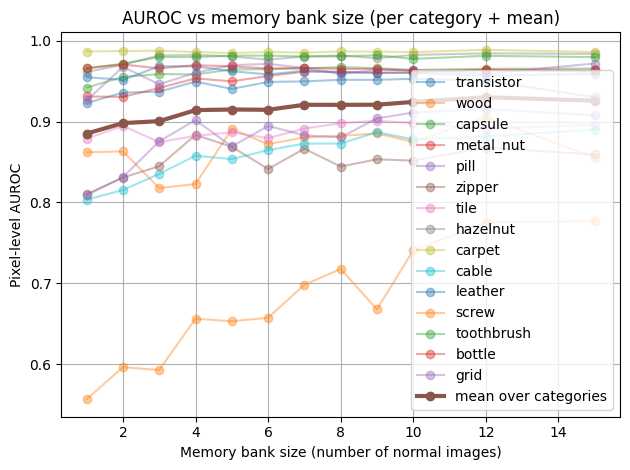

In [ ]:



size_of_memory = [1, 2, 3, 4, 5, 6, 7, 8, 9, 10, 12, 15]

results_auc = {cat: [] for cat in categories}
results_sizes = {cat: [] for cat in categories}

auc_per_size = defaultdict(list)

for category in categories:
    print(f"\n=== Category: {category} ===")
    max_train = len(all_normal_embeddings[category])
    print(f"  Normal train images available: {max_train}")

    for memory_size in size_of_memory:
        if memory_size > max_train:
            continue  

        print(f"\n  >> Evaluating memory = {memory_size}")
        memory_bank = make_memory_bank(category, all_normal_embeddings, memory_size, seed=42)

        auc = evaluate_auc(category, model, memory_bank)
        print(f"     AUROC = {auc:.4f}")

        results_sizes[category].append(memory_size)
        results_auc[category].append(auc)

        auc_per_size[memory_size].append(auc)


# ---- compute average AUROC per memory size ----
avg_auc_per_size = {
    m: np.mean(auc_list) for m, auc_list in auc_per_size.items()
}

print("\n=== Average AUROC over all categories ===")
for m in sorted(avg_auc_per_size.keys()):
    print(f"Memory {m:2d}: mean AUROC = {avg_auc_per_size[m]:.4f}")

# ---- single plot: all category curves + mean curve ----
plt.figure()

# plot each category
for category in categories:
    if len(results_sizes[category]) == 0:
        continue
    plt.plot(
        results_sizes[category],
        results_auc[category],
        marker='o',
        linestyle='-',
        alpha=0.4,
        label=category
    )

# plot mean curve on top
sizes_sorted = sorted(avg_auc_per_size.keys())
mean_aucs = [avg_auc_per_size[m] for m in sizes_sorted]

plt.plot(
    sizes_sorted,
    mean_aucs,
    marker='o',
    linestyle='-',
    linewidth=3,
    label="mean over categories"
)

plt.xlabel("Memory bank size (number of normal images)")
plt.ylabel("Pixel-level AUROC")
plt.title("AUROC vs memory bank size (per category + mean)")
plt.grid(True)
plt.legend()
plt.tight_layout()
plt.show()


/var/folders/tk/vby2xctj2yz8kn6p_xgfvcd80000gn/T/ipykernel_14187/1337388442.py:6: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = plt.cm.get_cmap("tab20", num_cats)


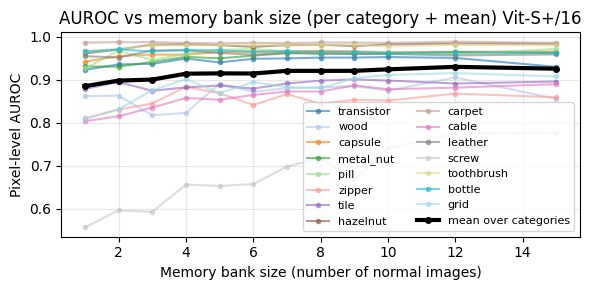

In [62]:

import matplotlib.pyplot as plt
import numpy as np

# get a colormap with enough distinct colors (20 > 15 categories)
num_cats = len(categories)
cmap = plt.cm.get_cmap("tab20", num_cats)

plt.figure(figsize=(6, 3))

# per-category curves
for i, category in enumerate(categories):
    if len(results_sizes[category]) == 0:
        continue

    plt.plot(
        results_sizes[category],
        results_auc[category],
        marker='o',
        markersize=3,          # smaller marker
        linestyle='-',
        alpha=0.6,
        color=cmap(i),         # unique color per category
        label=category
    )

# mean curve on top
sizes_sorted = sorted(avg_auc_per_size.keys())
mean_aucs = [avg_auc_per_size[m] for m in sizes_sorted]

plt.plot(
    sizes_sorted,
    mean_aucs,
    marker='o',
    markersize=4,
    linestyle='-',
    linewidth=3,
    color='black',           # stand out
    label="mean over categories"
)

plt.xlabel("Memory bank size (number of normal images)")
plt.ylabel("Pixel-level AUROC")
plt.title("AUROC vs memory bank size (per category + mean) Vit-S+/16")
plt.grid(True, alpha=0.3)
plt.legend(fontsize=8, ncol=2)
plt.tight_layout()
plt.show()





In [ ]:
import random
import matplotlib.pyplot as plt

def plot_memory_bank_examples_per_category(
    Ks=(1, 3, 5, 10, 15),
    categories_to_use=None,
    patch_size=16,
    seed=0
):
    """
    For each category:
      - pick a random anomalous test image with GT
      - plot original + GT outline
      - plot anomaly maps for memory sizes K in Ks (no GT overlay)
    """
    if categories_to_use is None:
        categories_to_use = categories  # use all categories if not specified

    rng = np.random.default_rng(seed)

    for category in categories_to_use:
        print(f"\n=== Category: {category} ===")
        test_dir = os.path.join(root_dir, category, "test")

        # ---- pick one random anomalous image with GT ----
        chosen_img = None
        chosen_gt = None

        # shuffle anomaly types so it’s not always the same one
        anomaly_types = [a for a in all_anomaly_types[category] if a != "good"]
        rng.shuffle(anomaly_types)

        for anomaly_type in anomaly_types:
            anomaly_dir = os.path.join(test_dir, anomaly_type)
            if not os.path.isdir(anomaly_dir):
                continue

            img_candidates = [f for f in os.listdir(anomaly_dir) if f.endswith(".png")]
            if not img_candidates:
                continue

            img_name = rng.choice(img_candidates)
            img_path = os.path.join(anomaly_dir, img_name)

            gt_path = os.path.join(
                root_dir,
                category,
                "ground_truth",
                anomaly_type,
                img_name.replace(".png", "_mask.png")
            )

            if not os.path.exists(gt_path):
                print(f"  No GT found for {img_path}, skipping.")
                continue

            chosen_img = img_path
            chosen_gt = gt_path
            print(f"  Using image: {img_name} (anomaly type: {anomaly_type})")
            break

        if chosen_img is None:
            print("  No anomalous image with GT found for this category, skipping.")
            continue

        # ---- load image + GT once ----
        img = np.array(Image.open(chosen_img).convert("RGB"))
        h, w, _ = img.shape
        gt_img = np.array(Image.open(chosen_gt).convert("L"))
        gt_binary = (gt_img > 127).astype(int)

        # ---- figure: 1 (orig+GT) + len(Ks) anomaly maps ----
        n_cols = 1 + len(Ks)
        fig, axes = plt.subplots(1, n_cols, figsize=(4 * n_cols, 4))

        # column 0: original + GT outline
        ax0 = axes[0]
        ax0.imshow(img)
        ax0.contour(gt_binary, levels=[0.5], colors="lime", linewidths=2)
        ax0.set_title("Original + GT")
        ax0.axis("off")

        # ---- columns 1..: anomaly maps for each K ----
        for j, K in enumerate(Ks, start=1):
            if K > len(all_normal_embeddings[category]):
                print(f"  K={K} > number of normal images, skipping.")
                continue

            # build memory bank of size K
            memory_bank = make_memory_bank(category, all_normal_embeddings, memory_size=K, seed=seed)

            # compute anomaly scores + map
            anomaly_scores = compute_anomaly_scores(model, chosen_img, memory_bank)
            score_grid = find_score_grid(anomaly_scores, chosen_img, patch_size=patch_size)

            ax = axes[j]
            ax.imshow(img)
            ax.imshow(score_grid, cmap="jet", alpha=0.5)
            ax.set_title(f"K = {K}")
            ax.axis("off")

        plt.suptitle(f"Category: {category} – Memory bank anomaly maps", y=1.03)
        plt.tight_layout()
        plt.show()




=== Category: transistor ===
  Using image: 004.png (anomaly type: misplaced)


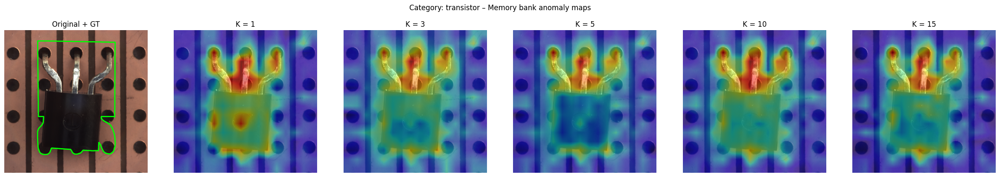


=== Category: wood ===
  Using image: 001.png (anomaly type: liquid)


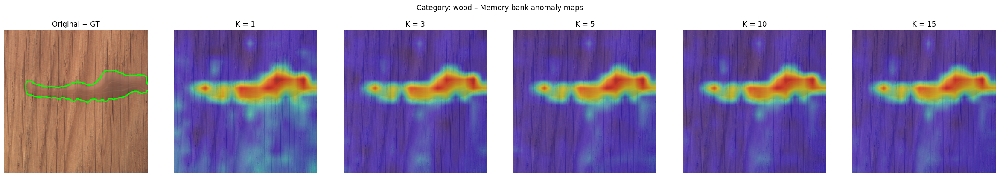


=== Category: capsule ===
  Using image: 022.png (anomaly type: crack)


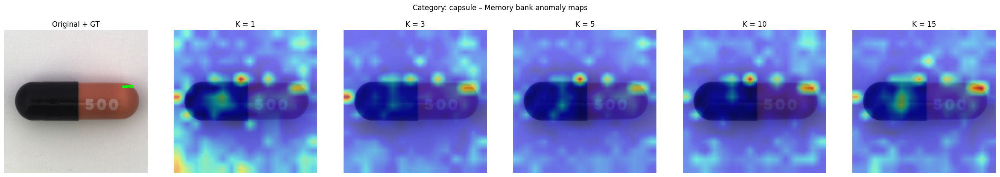


=== Category: metal_nut ===
  Using image: 004.png (anomaly type: color)


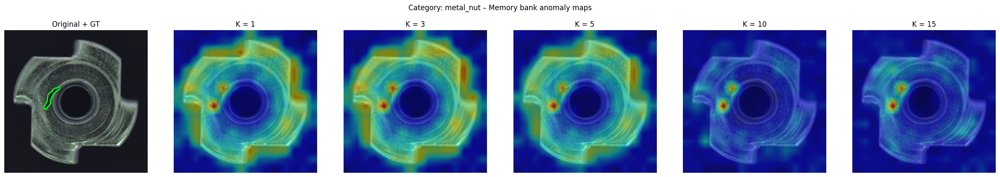


=== Category: pill ===
  Using image: 011.png (anomaly type: color)


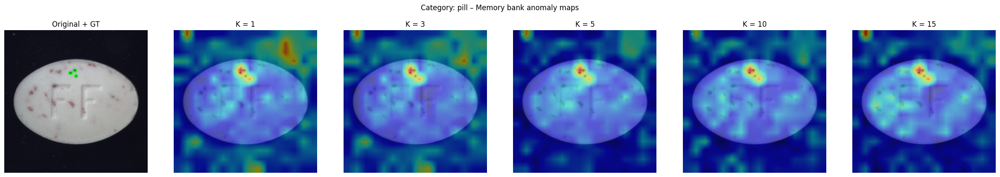


=== Category: zipper ===
  Using image: 000.png (anomaly type: combined)


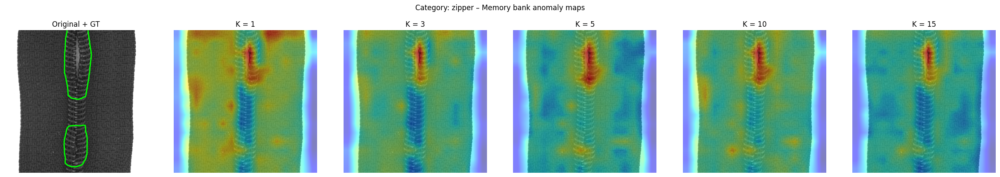


=== Category: tile ===
  Using image: 009.png (anomaly type: rough)


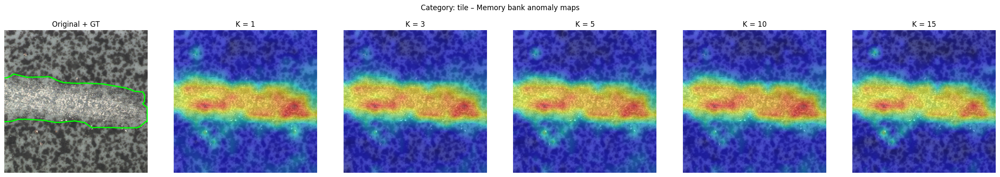


=== Category: hazelnut ===
  Using image: 013.png (anomaly type: hole)


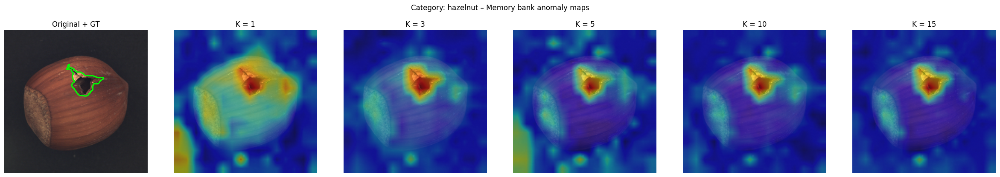


=== Category: carpet ===
  Using image: 005.png (anomaly type: color)


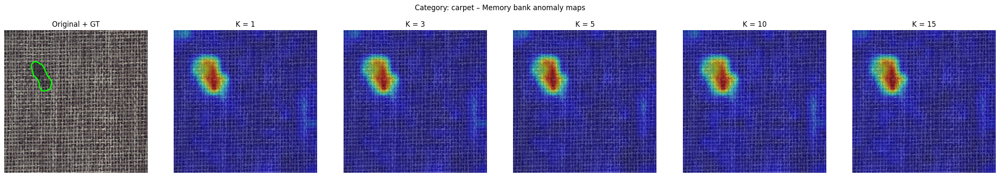


=== Category: cable ===
  Using image: 008.png (anomaly type: bent_wire)


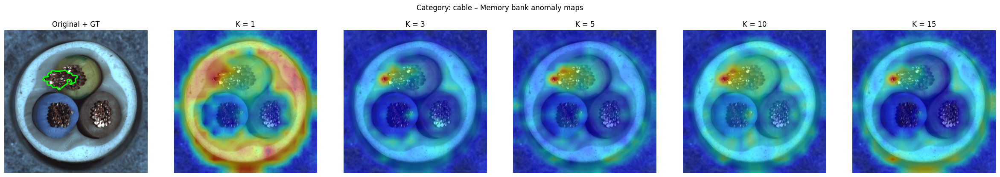


=== Category: leather ===
  Using image: 015.png (anomaly type: fold)


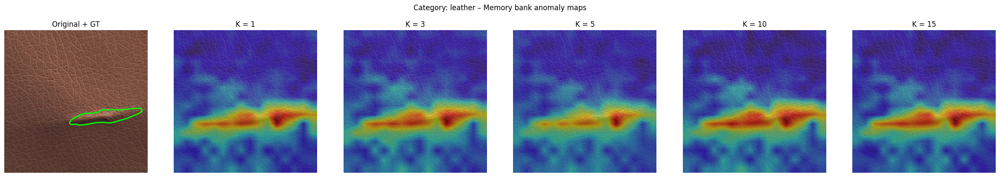


=== Category: screw ===
  Using image: 001.png (anomaly type: scratch_neck)


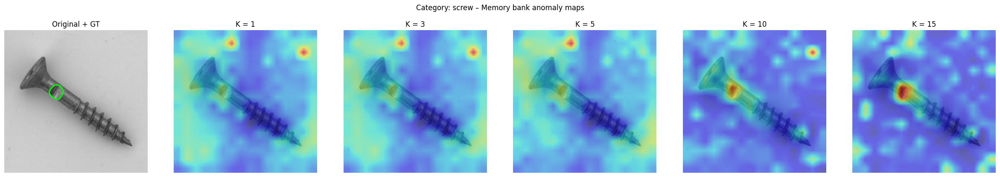


=== Category: toothbrush ===
  Using image: 012.png (anomaly type: defective)


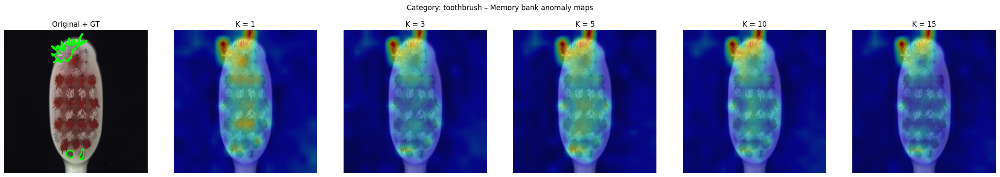


=== Category: bottle ===
  Using image: 004.png (anomaly type: contamination)


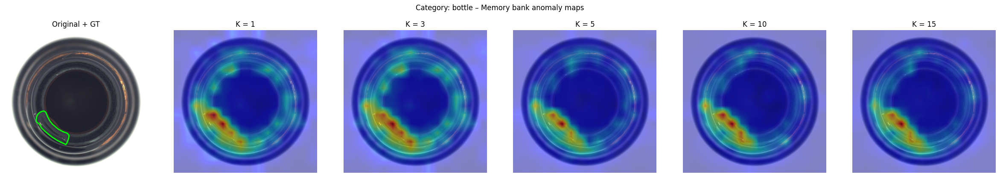


=== Category: grid ===
  Using image: 008.png (anomaly type: metal_contamination)


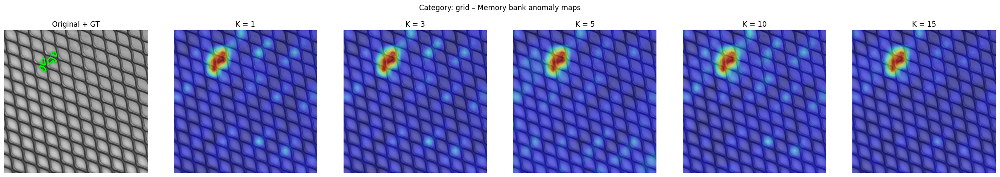

In [40]:
plot_memory_bank_examples_per_category(
    Ks=(1, 3, 5, 10, 15),
    categories_to_use=categories,   # or e.g. ["bottle", "capsule"]
    patch_size=16,
    seed=42
)



Picking image for category: metal_nut
  Using image: 005.png (anomaly type: scratch)

Picking image for category: grid
  Using image: 001.png (anomaly type: metal_contamination)

Picking image for category: leather
  Using image: 013.png (anomaly type: color)

Picking image for category: bottle
  Using image: 004.png (anomaly type: broken_small)

Picking image for category: pill
  Using image: 011.png (anomaly type: color)

Picking image for category: hazelnut
  Using image: 005.png (anomaly type: cut)

Picking image for category: carpet
  Using image: 011.png (anomaly type: cut)

Picking image for category: capsule
  Using image: 018.png (anomaly type: crack)


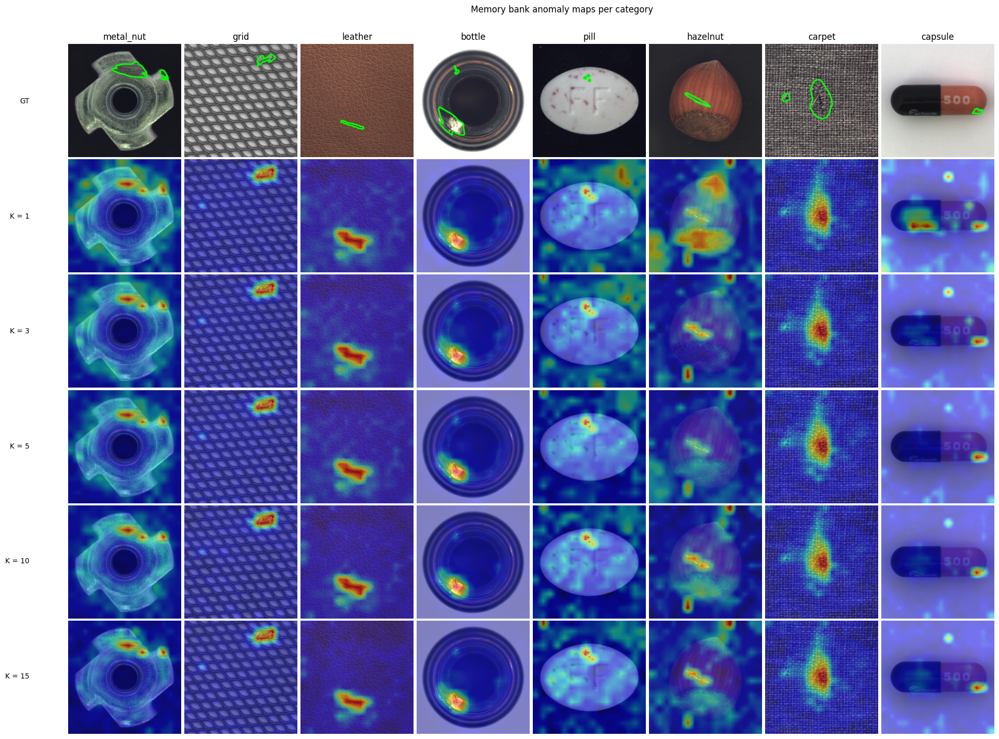

In [41]:
import random
import matplotlib.pyplot as plt
import numpy as np

def plot_memory_bank_grid(
    Ks=(1, 3, 5, 10, 15),
    categories_to_use=None,
    patch_size=16,
    seed=0
):
    """
    One big plot:
      - columns = selected categories
      - row 0 = original + GT
      - row r>0 = anomaly maps for K in Ks
      - row labels ('GT', 'K = ...') drawn on the left of the figure
    """
    if categories_to_use is None:
        categories_to_use = categories  # your global list

    rng = np.random.default_rng(seed)

    # --- 1) choose one anomalous image + GT per category ---
    cat_data = {}  # category -> (img_array, gt_binary, img_path)

    for category in categories_to_use:
        print(f"\nPicking image for category: {category}")
        test_dir = os.path.join(root_dir, category, "test")

        anomaly_types = [a for a in all_anomaly_types[category] if a != "good"]
        rng.shuffle(anomaly_types)

        for anomaly_type in anomaly_types:
            anomaly_dir = os.path.join(test_dir, anomaly_type)
            if not os.path.isdir(anomaly_dir):
                continue

            img_candidates = [f for f in os.listdir(anomaly_dir) if f.endswith(".png")]
            if not img_candidates:
                continue

            img_name = rng.choice(img_candidates)
            img_path = os.path.join(anomaly_dir, img_name)

            gt_path = os.path.join(
                root_dir,
                category,
                "ground_truth",
                anomaly_type,
                img_name.replace(".png", "_mask.png")
            )

            if not os.path.exists(gt_path):
                print(f"  No GT for {img_path}, skipping.")
                continue

            img = np.array(Image.open(img_path).convert("RGB"))
            gt_img = np.array(Image.open(gt_path).convert("L"))
            gt_binary = (gt_img > 127).astype(int)

            cat_data[category] = (img, gt_binary, img_path)
            print(f"  Using image: {img_name} (anomaly type: {anomaly_type})")
            break

        if category not in cat_data:
            print(f"  No anomalous image with GT found for {category}, dropping from grid.")

    categories_used = list(cat_data.keys())
    if len(categories_used) == 0:
        print("No categories with valid images/GT found.")
        return

    # --- 2) build the grid plot ---
    n_cols = len(categories_used)
    n_rows = 1 + len(Ks)  # row 0 = GT, rows 1.. = Ks

    fig, axes = plt.subplots(
        n_rows, n_cols,
        figsize=(3.0 * n_cols, 2.5 * n_rows),
    )

    if n_rows == 1:
        axes = np.expand_dims(axes, axis=0)
    if n_cols == 1:
        axes = np.expand_dims(axes, axis=1)

    for col, category in enumerate(categories_used):
        img, gt_binary, img_path = cat_data[category]

        # --- row 0: original + GT ---
        ax0 = axes[0, col]
        ax0.imshow(img)
        ax0.contour(gt_binary, levels=[0.5], colors="lime", linewidths=2)
        ax0.set_title(category)
        ax0.axis("off")

        # --- rows 1..: anomaly maps for each K ---
        for r, K in enumerate(Ks, start=1):
            ax = axes[r, col]

            if K > len(all_normal_embeddings[category]):
                ax.axis("off")
                continue

            memory_bank = make_memory_bank(category, all_normal_embeddings,
                                           memory_size=K, seed=seed)
            anomaly_scores = compute_anomaly_scores(model, img_path, memory_bank)
            score_grid = find_score_grid(anomaly_scores, img_path, patch_size=patch_size)

            ax.imshow(img)
            ax.imshow(score_grid, cmap="jet", alpha=0.5)
            ax.axis("off")

    # --- tighten spacing ---
    plt.subplots_adjust(left=0.1, right=0.85, top=0.92, bottom=0.03,
                        wspace=0.0001, hspace=0.02)

    # --- add row labels on the left via fig.text ---
    row_labels = ["GT"] + [f"K = {K}" for K in Ks]
    sp = fig.subplotpars
    row_height = (sp.top - sp.bottom) / n_rows

    for r, label in enumerate(row_labels):
        # vertical center of each row in figure coordinates
        y = sp.top - (r + 0.5) * row_height
        fig.text(
            x=sp.left - 0.03,  # a bit left of the first column
            y=y,
            s=label,
            ha="right",
            va="center",
            fontsize=10,
        )

    plt.suptitle("Memory bank anomaly maps per category", y=0.97)
    plt.show()

plot_memory_bank_grid(
    Ks=(1, 3, 5, 10, 15),
    categories_to_use=["metal_nut","grid", "leather", "bottle", "pill", "hazelnut", "carpet", "capsule"],
    patch_size=16,
    seed=42
)



## Zero-shot by mirroring 

In [42]:
@torch.no_grad()
def get_embeddings_pil(model, pil_img):
    img_t = transform(pil_img).unsqueeze(0).to(device)
    feats = model.forward_features(img_t)
    patch_tokens = feats["x_norm_patchtokens"] 
    return patch_tokens.squeeze(0).cpu().numpy() 



In [ ]:
def mirroring_anomaly_score(model, img_path):
    img = Image.open(img_path).convert("RGB")
    img_mirrored = img.transpose(Image.FLIP_LEFT_RIGHT)

    embedding = get_embeddings_pil(model, img)
    mirrored_embedding = get_embeddings_pil(model, img_mirrored)

    cos_sim = cosine_similarity(embedding, mirrored_embedding)

    diag = np.diag(cos_sim)

    anomaly_score = 1 - diag

    return anomaly_score




In [44]:
def evaluate_auc_mirroring(category, model):
    test_dir = os.path.join(root_dir, category, "test")

    all_gt = []
    all_scores = []

    for anomaly_type in all_anomaly_types[category]:
        anomaly_dir = os.path.join(test_dir, anomaly_type)
        print(f"  - anomaly type: {anomaly_type}")

        for img in os.listdir(anomaly_dir):
            if not img.endswith(".png"):
                continue

            img_path = os.path.join(anomaly_dir, img)

            
            anomaly_scores = mirroring_anomaly_score(model, img_path)
            score_grid = find_score_grid(anomaly_scores, img_path, patch_size=16)

         
            if anomaly_type == "good":
                gt_binary = np.zeros_like(score_grid)
            else:
                gt_path = os.path.join(
                    root_dir, category, "ground_truth", anomaly_type,
                    img.replace(".png", "_mask.png")
                )
                gt_img = np.array(Image.open(gt_path).convert("L"))
                gt_binary = (gt_img > 127).astype(int)

            all_gt.append(gt_binary.flatten())
            all_scores.append(score_grid.flatten())

    all_gt = np.concatenate(all_gt)
    all_scores = np.concatenate(all_scores)

    auc_roc = roc_auc_score(all_gt, all_scores)
    return auc_roc


=== Mirroring experiment: transistor ===
  - anomaly type: bent_lead
  - anomaly type: cut_lead
  - anomaly type: damaged_case
  - anomaly type: good
  - anomaly type: misplaced
Pixel-level AUROC (mirroring): 0.7353

=== Mirroring experiment: wood ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: good
  - anomaly type: hole
  - anomaly type: liquid
  - anomaly type: scratch
Pixel-level AUROC (mirroring): 0.8763

=== Mirroring experiment: capsule ===
  - anomaly type: crack
  - anomaly type: faulty_imprint
  - anomaly type: good
  - anomaly type: poke
  - anomaly type: scratch
  - anomaly type: squeeze
Pixel-level AUROC (mirroring): 0.8678

=== Mirroring experiment: metal_nut ===
  - anomaly type: bent
  - anomaly type: color
  - anomaly type: flip
  - anomaly type: good
  - anomaly type: scratch
Pixel-level AUROC (mirroring): 0.4897

=== Mirroring experiment: pill ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: contamination
  - anomaly 

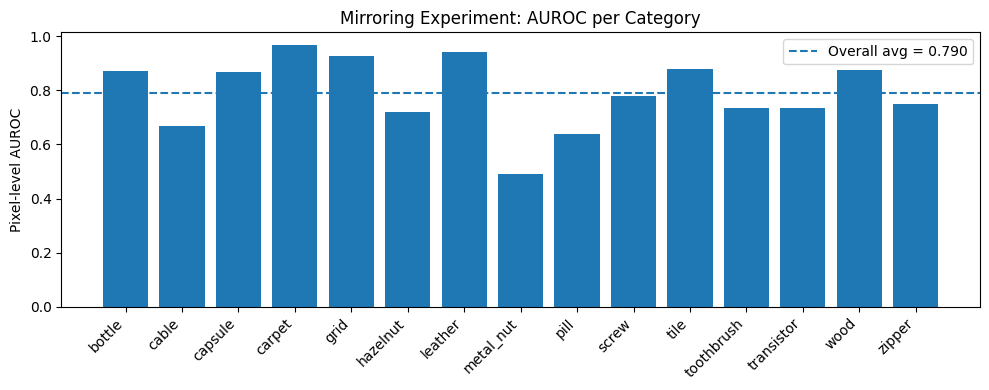

In [ ]:



# Compute AUROC per category for mirroring and plot

mirroring_results = {}  

test = ["bottle"]
for category in categories:  
    print(f"\n=== Mirroring experiment: {category} ===")
    auc_mirror = evaluate_auc_mirroring(category, model)
    mirroring_results[category] = auc_mirror
    print(f"Pixel-level AUROC (mirroring): {auc_mirror:.4f}")

# Compute overall average AUROC across categories
all_aucs = list(mirroring_results.values())
overall_avg_auc = float(np.mean(all_aucs))
print("\n===== Per-Category AUROC (Mirroring) =====")
for cat, auc in mirroring_results.items():
    print(f"{cat}: {auc:.4f}")
print(f"\nOverall average AUROC (mirroring): {overall_avg_auc:.4f}")

# Plot per-category AUROC with overall average line
plt.figure(figsize=(10, 4))
cats_sorted = sorted(mirroring_results.keys())
aucs_sorted = [mirroring_results[c] for c in cats_sorted]

plt.bar(cats_sorted, aucs_sorted)
plt.axhline(overall_avg_auc, linestyle='--', label=f'Overall avg = {overall_avg_auc:.3f}')
plt.xticks(rotation=45, ha='right')
plt.ylabel("Pixel-level AUROC")
plt.title("Mirroring Experiment: AUROC per Category")
plt.legend()
plt.tight_layout()
plt.show()



=== Category: transistor ===
  Using image: 006.png (anomaly type: bent_lead)


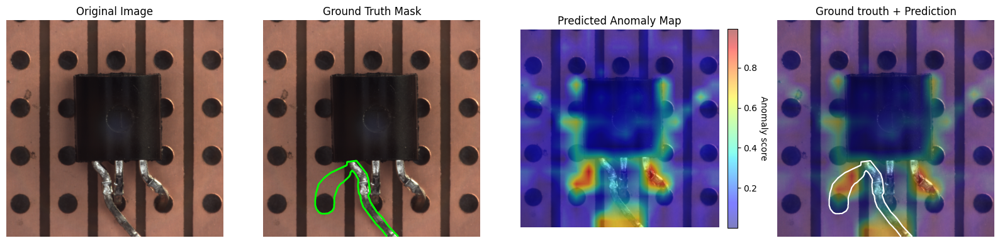


=== Category: wood ===
  Using image: 006.png (anomaly type: color)


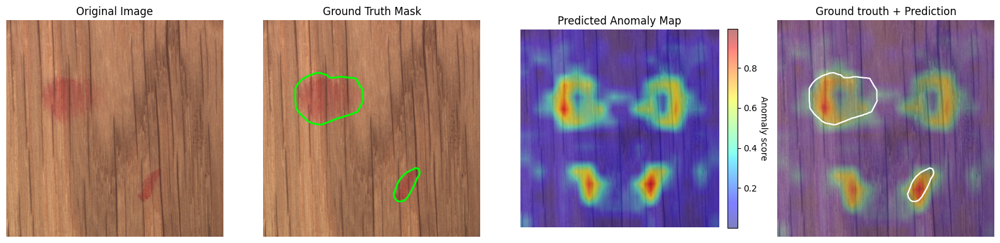


=== Category: capsule ===
  Using image: 007.png (anomaly type: crack)


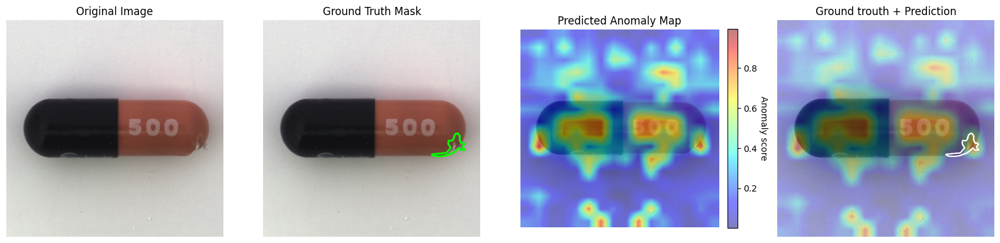


=== Category: metal_nut ===
  Using image: 003.png (anomaly type: bent)


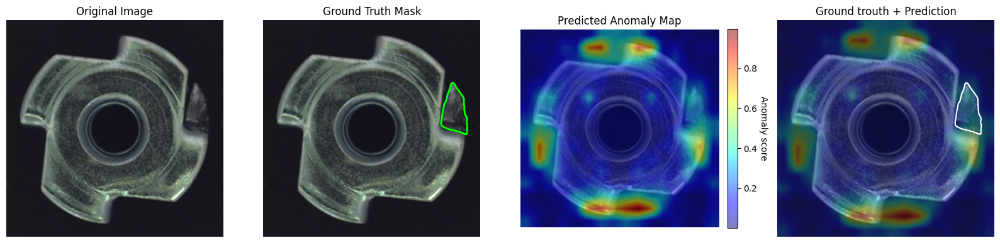


=== Category: pill ===
  Using image: 007.png (anomaly type: color)


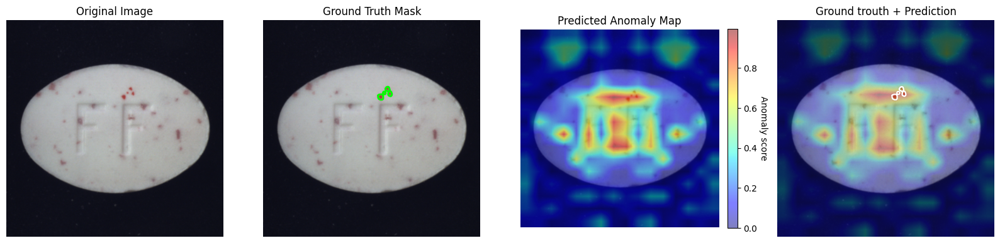


=== Category: zipper ===
  Using image: 000.png (anomaly type: broken_teeth)


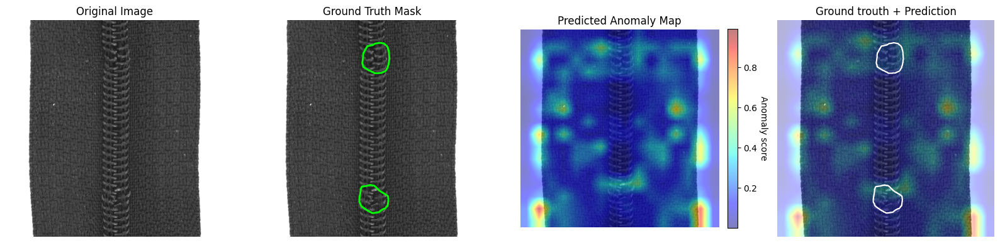


=== Category: tile ===
  Using image: 007.png (anomaly type: crack)


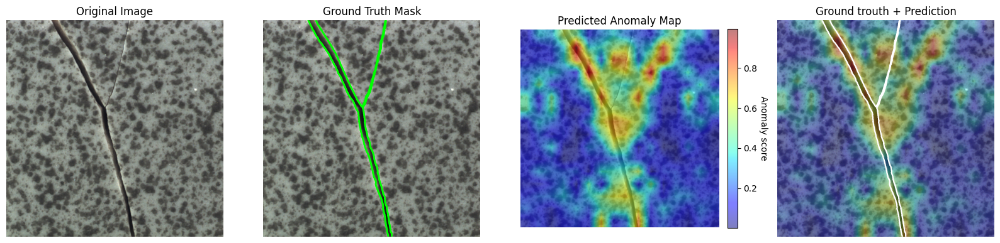


=== Category: hazelnut ===
  Using image: 003.png (anomaly type: crack)


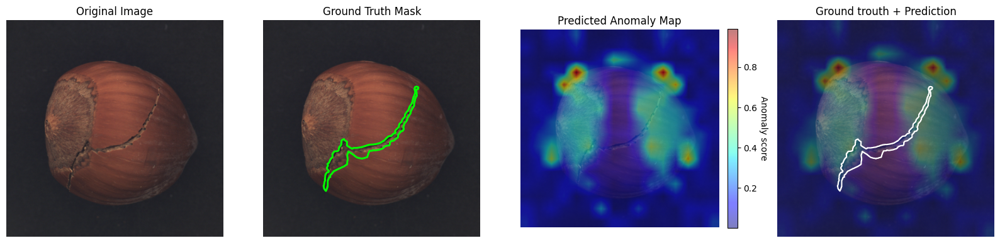


=== Category: carpet ===
  Using image: 014.png (anomaly type: color)


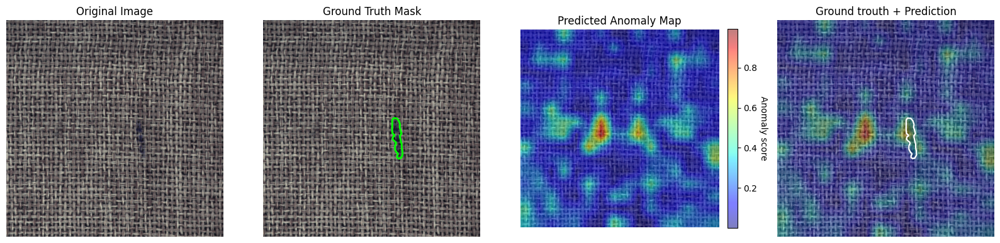


=== Category: cable ===
  Using image: 005.png (anomaly type: bent_wire)


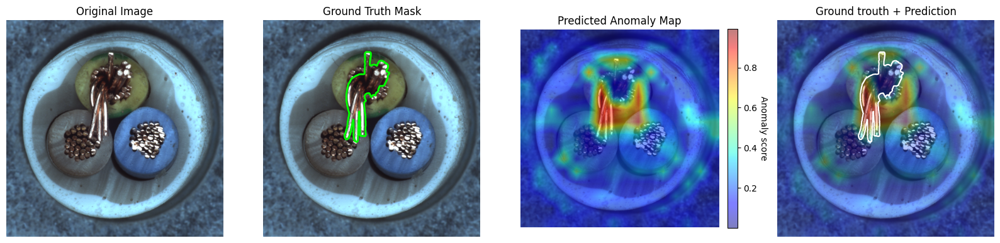


=== Category: leather ===
  Using image: 018.png (anomaly type: color)


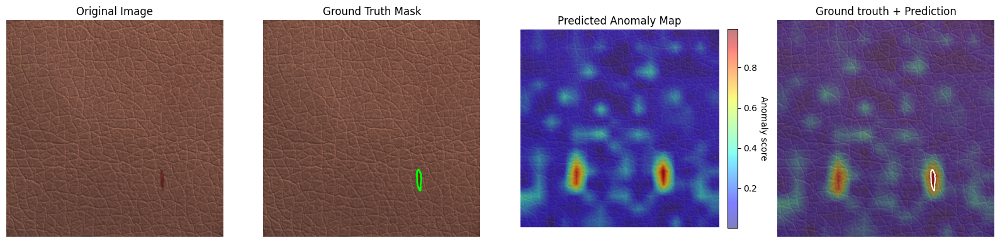


=== Category: screw ===
  Using image: 013.png (anomaly type: manipulated_front)


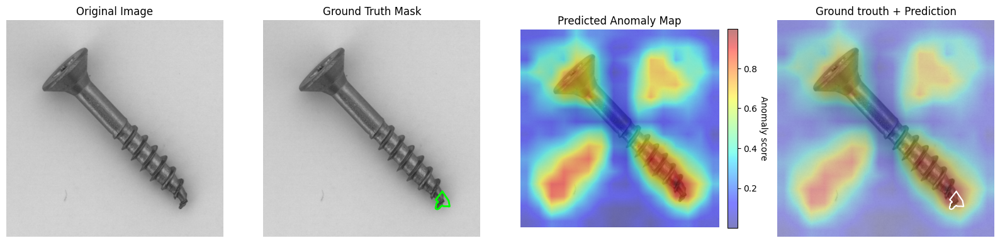


=== Category: toothbrush ===
  Using image: 010.png (anomaly type: defective)


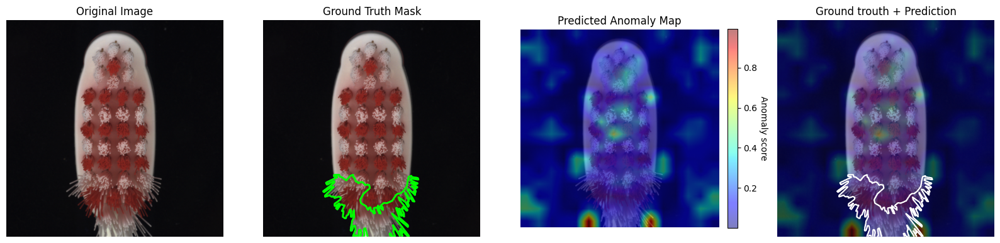


=== Category: bottle ===
  Using image: 017.png (anomaly type: broken_large)


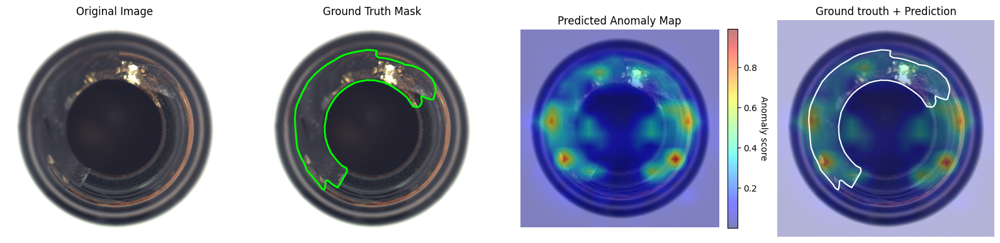


=== Category: grid ===
  Using image: 000.png (anomaly type: bent)


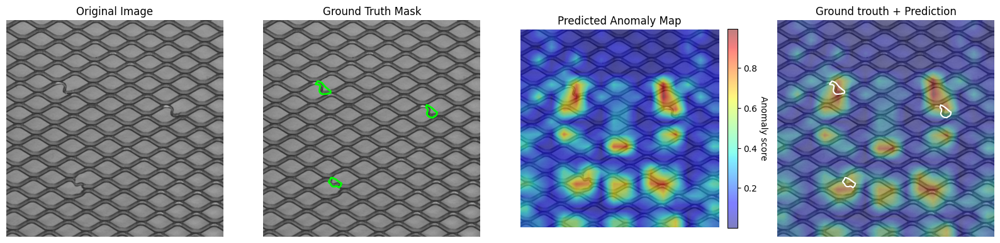

In [48]:
import random

def plot_mirroring_examples_per_category(categories_to_use=None, patch_size=16):
   
    if categories_to_use is None:
        categories_to_use = categories  # use all if not specified

    for category in categories_to_use:
        print(f"\n=== Category: {category} ===")
        test_dir = os.path.join(root_dir, category, "test")

        # Find first anomaly type that is not "good"
        chosen_img = None
        chosen_gt = None

        for anomaly_type in all_anomaly_types[category]:
            if anomaly_type == "good":
                continue  # skip normal images, we want to show a defect

            anomaly_dir = os.path.join(test_dir, anomaly_type)
            if not os.path.isdir(anomaly_dir):
                continue

            # pick first PNG (or random)
            img_candidates = [f for f in os.listdir(anomaly_dir) if f.endswith(".png")]
            if not img_candidates:
                continue

            img_name = random.choice(img_candidates)  # or img_candidates[0] if you want deterministic
            img_path = os.path.join(anomaly_dir, img_name)

            gt_path = os.path.join(
                root_dir,
                category,
                "ground_truth",
                anomaly_type,
                img_name.replace(".png", "_mask.png")
            )

            if not os.path.exists(gt_path):
                print(f"  No GT found for {img_path}, skipping.")
                continue

            chosen_img = img_path
            chosen_gt = gt_path
            print(f"  Using image: {img_name} (anomaly type: {anomaly_type})")
            break

        if chosen_img is None:
            print("  No anomalous image with GT found for this category, skipping.")
            continue

        # Compute mirroring anomaly scores
        anomaly_scores = mirroring_anomaly_score(model, chosen_img)

        # Plot anomaly map + GT using your existing function
        find_anomaly_map(
            anomaly_scores,
            test_img_path=chosen_img,
            ground_trouth_path=chosen_gt,
            patch_size=patch_size
        )

# Example: run for all categories
plot_mirroring_examples_per_category()


## Improvement self similarity (zero shot)

In [ ]:
from sklearn.metrics.pairwise import cosine_similarity

def self_similarity_anomaly_score(model, img_path, k):
    
    emb = get_embeddings(model, img_path)   
    
    # pairwise cosine similarity between all patches
    sim = cosine_similarity(emb, emb)       
    
    np.fill_diagonal(sim, -1.0)
    
    # take top-k most similar patches for each patch
    
    topk = np.sort(sim, axis=1)[:, -k:]     
    s = topk.mean(axis=1)                   
    
    anomaly_scores = 1.0 - s               
    return anomaly_scores



=== Category: transistor ===
  Using image: 000.png (anomaly type: bent_lead)


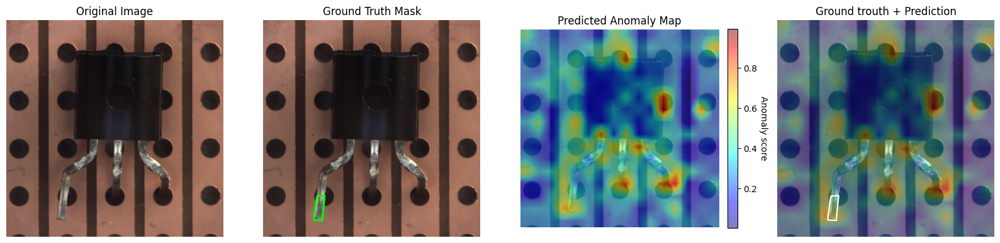


=== Category: wood ===
  Using image: 002.png (anomaly type: color)


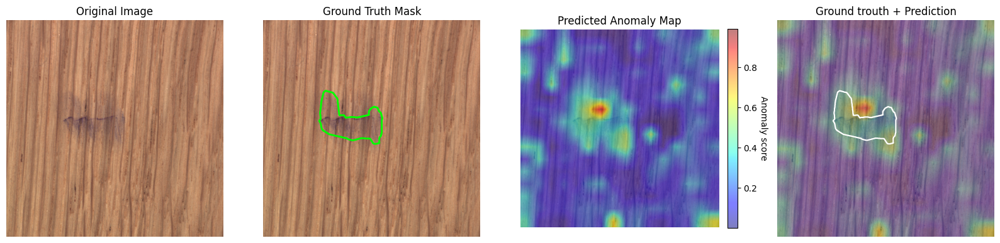


=== Category: capsule ===
  Using image: 014.png (anomaly type: crack)


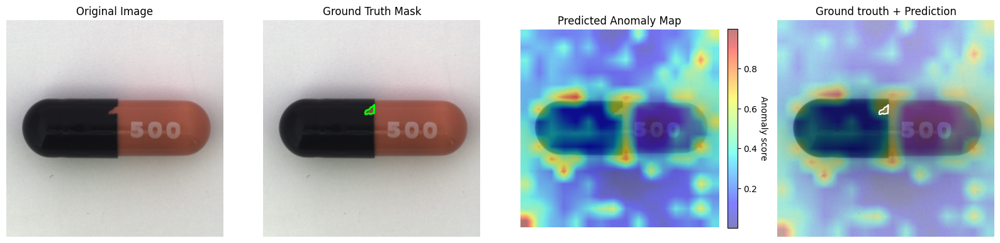


=== Category: metal_nut ===
  Using image: 006.png (anomaly type: bent)


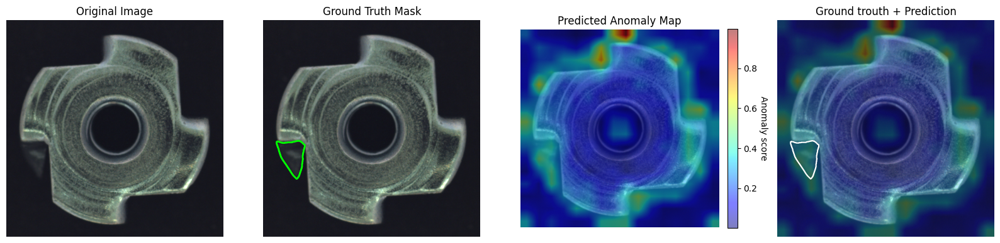


=== Category: pill ===
  Using image: 007.png (anomaly type: color)


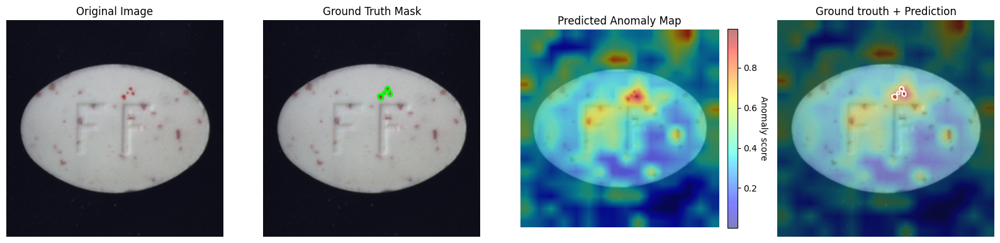


=== Category: zipper ===
  Using image: 012.png (anomaly type: broken_teeth)


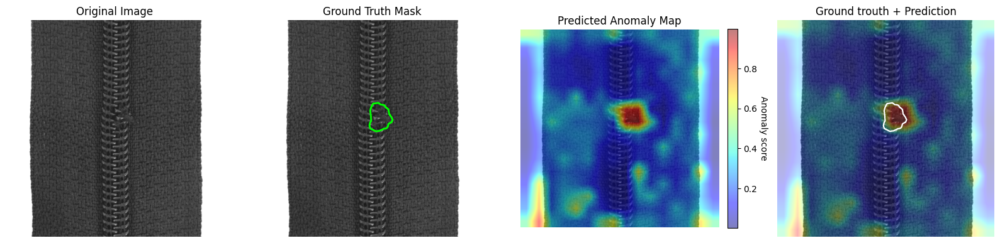


=== Category: tile ===
  Using image: 008.png (anomaly type: crack)


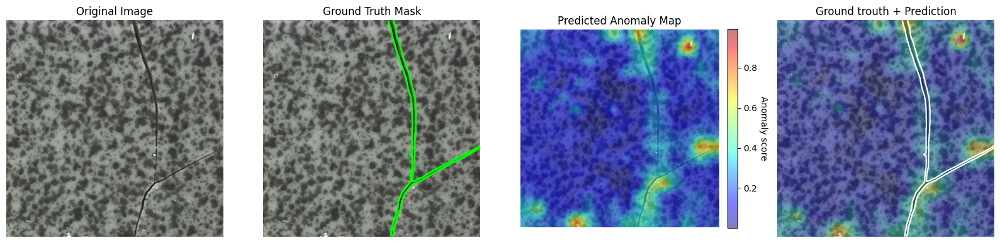


=== Category: hazelnut ===
  Using image: 008.png (anomaly type: crack)


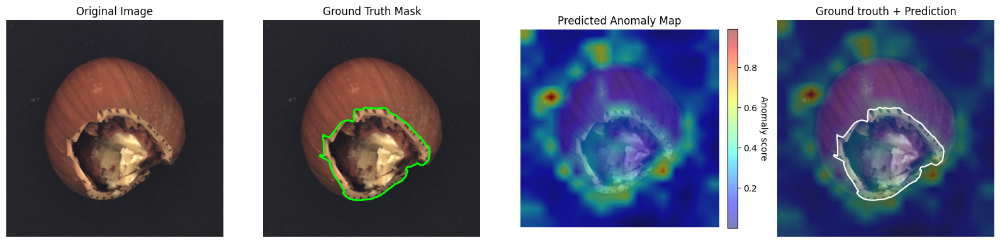


=== Category: carpet ===
  Using image: 009.png (anomaly type: color)


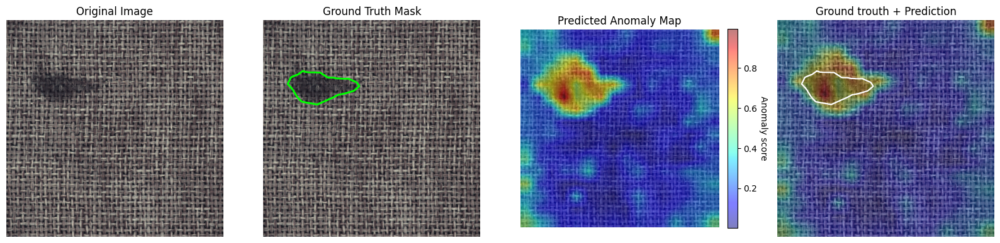


=== Category: cable ===
  Using image: 010.png (anomaly type: bent_wire)


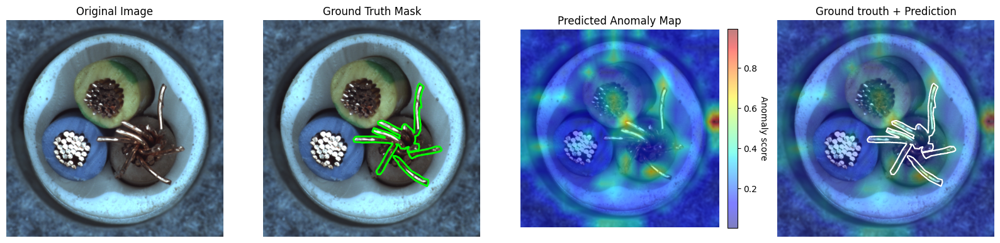


=== Category: leather ===
  Using image: 015.png (anomaly type: color)


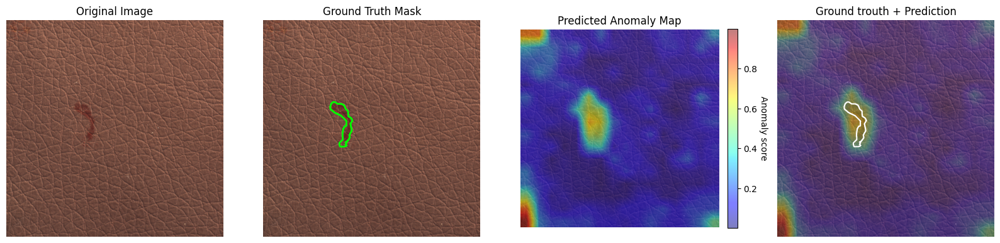


=== Category: screw ===
  Using image: 007.png (anomaly type: manipulated_front)


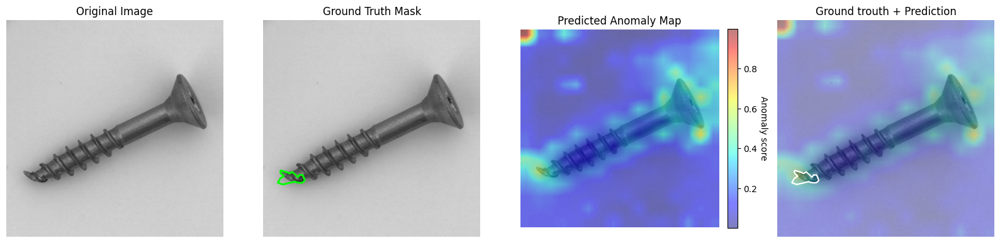


=== Category: toothbrush ===
  Using image: 017.png (anomaly type: defective)


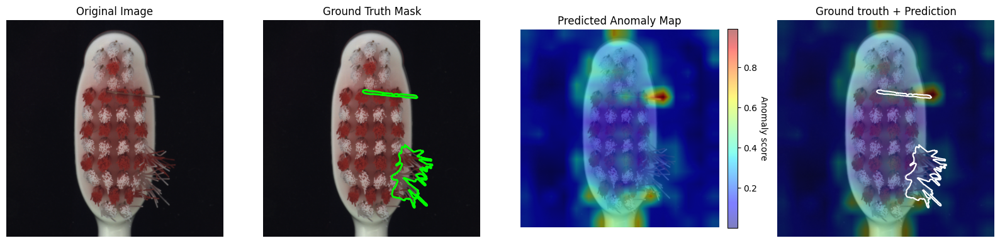


=== Category: bottle ===
  Using image: 016.png (anomaly type: broken_large)


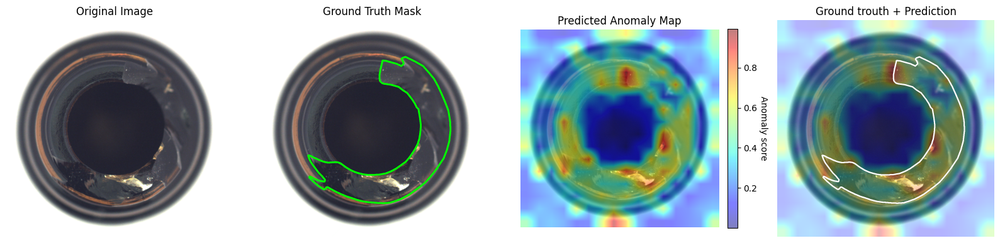


=== Category: grid ===
  Using image: 003.png (anomaly type: bent)


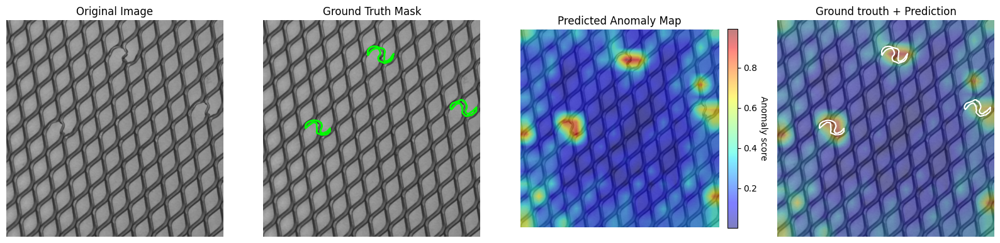

In [51]:

import random

def plot_self_examples_per_category(categories_to_use=None, patch_size=16):
   
    if categories_to_use is None:
        categories_to_use = categories  # use all if not specified

    for category in categories_to_use:
        print(f"\n=== Category: {category} ===")
        test_dir = os.path.join(root_dir, category, "test")

        # Find first anomaly type that is not "good"
        chosen_img = None
        chosen_gt = None

        for anomaly_type in all_anomaly_types[category]:
            if anomaly_type == "good":
                continue  # skip normal images, we want to show a defect

            anomaly_dir = os.path.join(test_dir, anomaly_type)
            if not os.path.isdir(anomaly_dir):
                continue

            # pick first PNG (or random)
            img_candidates = [f for f in os.listdir(anomaly_dir) if f.endswith(".png")]
            if not img_candidates:
                continue

            img_name = random.choice(img_candidates)  # or img_candidates[0] if you want deterministic
            img_path = os.path.join(anomaly_dir, img_name)

            gt_path = os.path.join(
                root_dir,
                category,
                "ground_truth",
                anomaly_type,
                img_name.replace(".png", "_mask.png")
            )

            if not os.path.exists(gt_path):
                print(f"  No GT found for {img_path}, skipping.")
                continue

            chosen_img = img_path
            chosen_gt = gt_path
            print(f"  Using image: {img_name} (anomaly type: {anomaly_type})")
            break

        if chosen_img is None:
            print("  No anomalous image with GT found for this category, skipping.")
            continue

        # Compute mirroring anomaly scores
        anomaly_scores = self_similarity_anomaly_score(model, chosen_img, k=5)
        

        # Plot anomaly map + GT using your existing function
        find_anomaly_map(
            anomaly_scores,
            test_img_path=chosen_img,
            ground_trouth_path=chosen_gt,
            patch_size=patch_size
        )

# Example: run for all categories
plot_self_examples_per_category()

In [52]:
def evaluate_auc_self(category, model):
    test_dir = os.path.join(root_dir, category, "test")

    all_gt = []
    all_scores = []

    for anomaly_type in all_anomaly_types[category]:
        anomaly_dir = os.path.join(test_dir, anomaly_type)
        print(f"  - anomaly type: {anomaly_type}")

        for img in os.listdir(anomaly_dir):
            if not img.endswith(".png"):
                continue

            img_path = os.path.join(anomaly_dir, img)

            anomaly_scores = self_similarity_anomaly_score(model, img_path, k=5)
            
            score_grid = find_score_grid(anomaly_scores, img_path, patch_size=16)

         
            if anomaly_type == "good":
                gt_binary = np.zeros_like(score_grid)
            else:
                gt_path = os.path.join(
                    root_dir, category, "ground_truth", anomaly_type,
                    img.replace(".png", "_mask.png")
                )
                gt_img = np.array(Image.open(gt_path).convert("L"))
                gt_binary = (gt_img > 127).astype(int)

            all_gt.append(gt_binary.flatten())
            all_scores.append(score_grid.flatten())

    all_gt = np.concatenate(all_gt)
    all_scores = np.concatenate(all_scores)

    auc_roc = roc_auc_score(all_gt, all_scores)
    return auc_roc


=== slef sim experiment: transistor ===
  - anomaly type: bent_lead
  - anomaly type: cut_lead
  - anomaly type: damaged_case
  - anomaly type: good
  - anomaly type: misplaced
Pixel-level AUROC (self): 0.5076

=== slef sim experiment: wood ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: good
  - anomaly type: hole
  - anomaly type: liquid
  - anomaly type: scratch
Pixel-level AUROC (self): 0.8909

=== slef sim experiment: capsule ===
  - anomaly type: crack
  - anomaly type: faulty_imprint
  - anomaly type: good
  - anomaly type: poke
  - anomaly type: scratch
  - anomaly type: squeeze
Pixel-level AUROC (self): 0.7508

=== slef sim experiment: metal_nut ===
  - anomaly type: bent
  - anomaly type: color
  - anomaly type: flip
  - anomaly type: good
  - anomaly type: scratch
Pixel-level AUROC (self): 0.3855

=== slef sim experiment: pill ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: contamination
  - anomaly type: crack
  - anomaly t

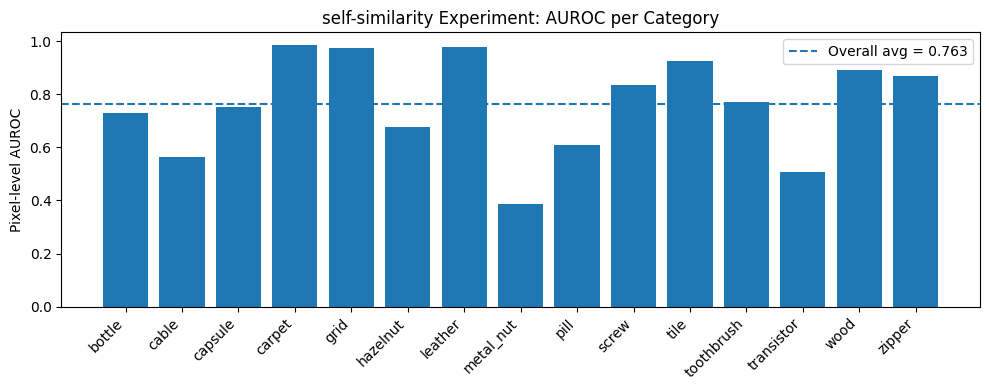

In [ ]:
# Compute AUROC per category for mirroring and plot

self_sim_results = {}  ´

test = ["bottle"]
for category in categories:  
    print(f"\n=== slef sim experiment: {category} ===")
    auc_self = evaluate_auc_self(category, model)
    self_sim_results[category] = auc_self
    print(f"Pixel-level AUROC (self): {auc_self:.4f}")

# Compute overall average AUROC across categories
all_aucs = list(self_sim_results.values())
overall_avg_auc = float(np.mean(all_aucs))
print("\n===== Per-Category AUROC (self) =====")
for cat, auc in self_sim_results.items():
    print(f"{cat}: {auc:.4f}")
print(f"\nOverall average AUROC (self): {overall_avg_auc:.4f}")

# Plot per-category AUROC with overall average line
plt.figure(figsize=(10, 4))
cats_sorted = sorted(self_sim_results.keys())
aucs_sorted = [self_sim_results[c] for c in cats_sorted]

plt.bar(cats_sorted, aucs_sorted)
plt.axhline(overall_avg_auc, linestyle='--', label=f'Overall avg = {overall_avg_auc:.3f}')
plt.xticks(rotation=45, ha='right')
plt.ylabel("Pixel-level AUROC")
plt.title("self-similarity Experiment: AUROC per Category")
plt.legend()
plt.tight_layout()
plt.show()

# Combined Zero-shot method

In [ ]:
def combined_anomaly_score(model, img_path, patch_size=16, k=5, alpha=0.5):
    
    # patch-level scores from both methods
    a_mirror = mirroring_anomaly_score(model, img_path)
    a_self   = self_similarity_anomaly_score(model, img_path, k=k)

    # per-image min-max normalization
    def min_max_norm(x):
        x = x.astype(np.float32)
        min_x = x.min()
        max_x = x.max()
        return (x - min_x) / (max_x - min_x + 1e-8)

    a_mirror_n = min_max_norm(a_mirror)
    a_self_n   = min_max_norm(a_self)


    a_comb = alpha * a_mirror_n + (1.0 - alpha) * a_self_n
    return a_comb



def evaluate_auc_combined(category, model, patch_size=16, k=8, alpha=0.5):
    test_dir = os.path.join(root_dir, category, "test")

    all_gt = []
    all_scores = []

    for anomaly_type in all_anomaly_types[category]:
        anomaly_dir = os.path.join(test_dir, anomaly_type)
        if not os.path.isdir(anomaly_dir):
            continue

        print(f"  - anomaly type: {anomaly_type}")

        for img in os.listdir(anomaly_dir):
            if not img.endswith(".png"):
                continue

            img_path = os.path.join(anomaly_dir, img)

  
            anomaly_scores = combined_anomaly_score(
                model,
                img_path,
                patch_size=patch_size,
                k=k,
                alpha=alpha
            )

            
            score_grid = find_score_grid(anomaly_scores, img_path, patch_size=patch_size)

            if anomaly_type == "good":
                gt_binary = np.zeros_like(score_grid)
            else:
                gt_path = os.path.join(
                    root_dir, category, "ground_truth", anomaly_type,
                    img.replace(".png", "_mask.png")
                )
                if not os.path.exists(gt_path):
                    print(f"    !! Missing GT for {img_path}, skipping.")
                    continue

                gt_img = np.array(Image.open(gt_path).convert("L"))
                gt_binary = (gt_img > 127).astype(int)

            all_gt.append(gt_binary.flatten())
            all_scores.append(score_grid.flatten())

    if len(all_gt) == 0:
        print("No valid images for AUROC computation.")
        return None

    all_gt = np.concatenate(all_gt)
    all_scores = np.concatenate(all_scores)

    auc_roc = roc_auc_score(all_gt, all_scores)
    return auc_roc



=== slef sim experiment: transistor ===
  - anomaly type: bent_lead
  - anomaly type: cut_lead
  - anomaly type: damaged_case
  - anomaly type: good
  - anomaly type: misplaced
Pixel-level AUROC (combined): 0.7082

=== slef sim experiment: wood ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: good
  - anomaly type: hole
  - anomaly type: liquid
  - anomaly type: scratch
Pixel-level AUROC (combined): 0.9001

=== slef sim experiment: capsule ===
  - anomaly type: crack
  - anomaly type: faulty_imprint
  - anomaly type: good
  - anomaly type: poke
  - anomaly type: scratch
  - anomaly type: squeeze
Pixel-level AUROC (combined): 0.8400

=== slef sim experiment: metal_nut ===
  - anomaly type: bent
  - anomaly type: color
  - anomaly type: flip
  - anomaly type: good
  - anomaly type: scratch
Pixel-level AUROC (combined): 0.5184

=== slef sim experiment: pill ===
  - anomaly type: color
  - anomaly type: combined
  - anomaly type: contamination
  - anomaly type: cra

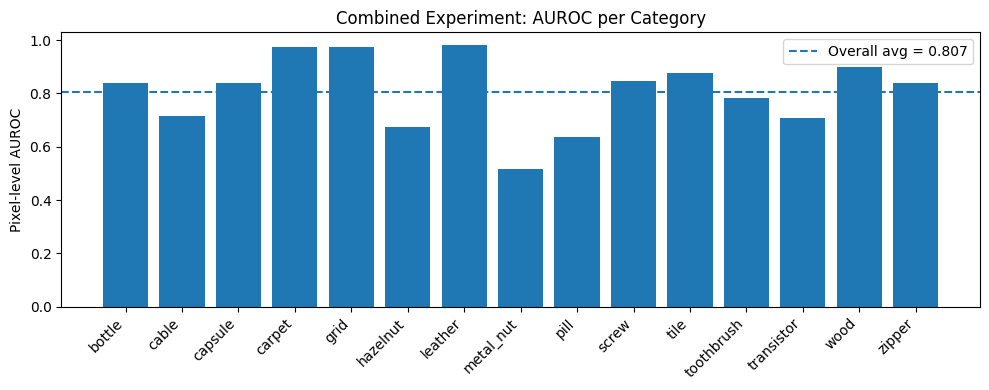

In [ ]:
combined_results = {}  


for category in categories:   
    print(f"\n=== slef sim experiment: {category} ===")
    auc_combined = evaluate_auc_combined(category, model)
    combined_results[category] = auc_combined
    print(f"Pixel-level AUROC (combined): {auc_combined:.4f}")

# Compute overall average AUROC across categories
all_aucs = list(combined_results.values())
overall_avg_auc = float(np.mean(all_aucs))
print("\n===== Per-Category AUROC (combined) =====")
for cat, auc in combined_results.items():
    print(f"{cat}: {auc:.4f}")
print(f"\nOverall average AUROC (combined): {overall_avg_auc:.4f}")

# Plot per-category AUROC with overall average line
plt.figure(figsize=(10, 4))
cats_sorted = sorted(combined_results.keys())
aucs_sorted = [combined_results[c] for c in cats_sorted]

plt.bar(cats_sorted, aucs_sorted)
plt.axhline(overall_avg_auc, linestyle='--', label=f'Overall avg = {overall_avg_auc:.3f}')
plt.xticks(rotation=45, ha='right')
plt.ylabel("Pixel-level AUROC")
plt.title("Combined Experiment: AUROC per Category")
plt.legend()
plt.tight_layout()
plt.show()